# Array measurements ROBAT 226.238:
- 5 mic array adafruit 5 i2s 
- 48khz 
- 1.5 meters distance (~ far field = 10𝛌; 𝛌max = fmin; 343/2 = 171 Hz --> 10𝛌 = 1715 Hz; at 1000Hz: 4.5𝛌 = 4.5*0.343 = 1.5435 m)
- measured clockwise (R: 0-180; L: 180-360)
- array rotated around the central mic kept a 1.5m from source

**HW settings:**
- Harman kandon AWR 445 vol = -25 db (front: 270 to 90)
- Harman kandon AWR 445 vol = -5 db (back: 100 to 260)
- fireface analog out 1/2 stereo vol = 0db
- tweeter #1
- Ref mic: gras +30 db fireface channel 9, +20db channel A power module

**NOTE:**


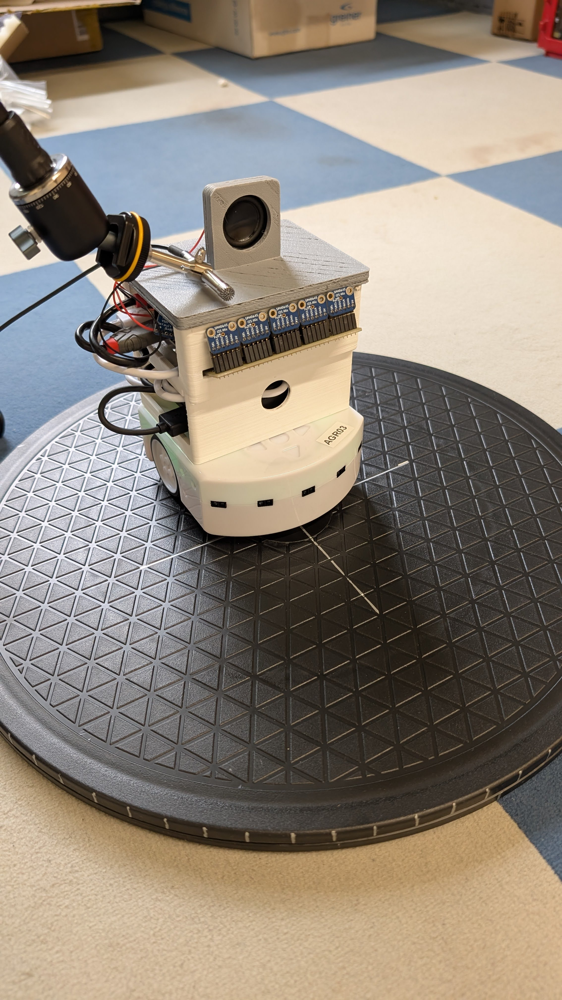

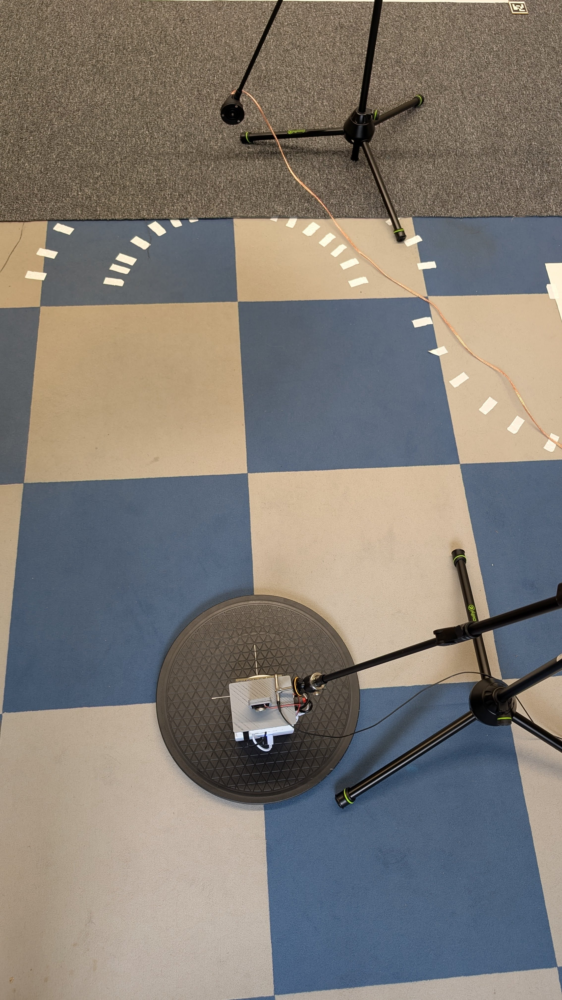

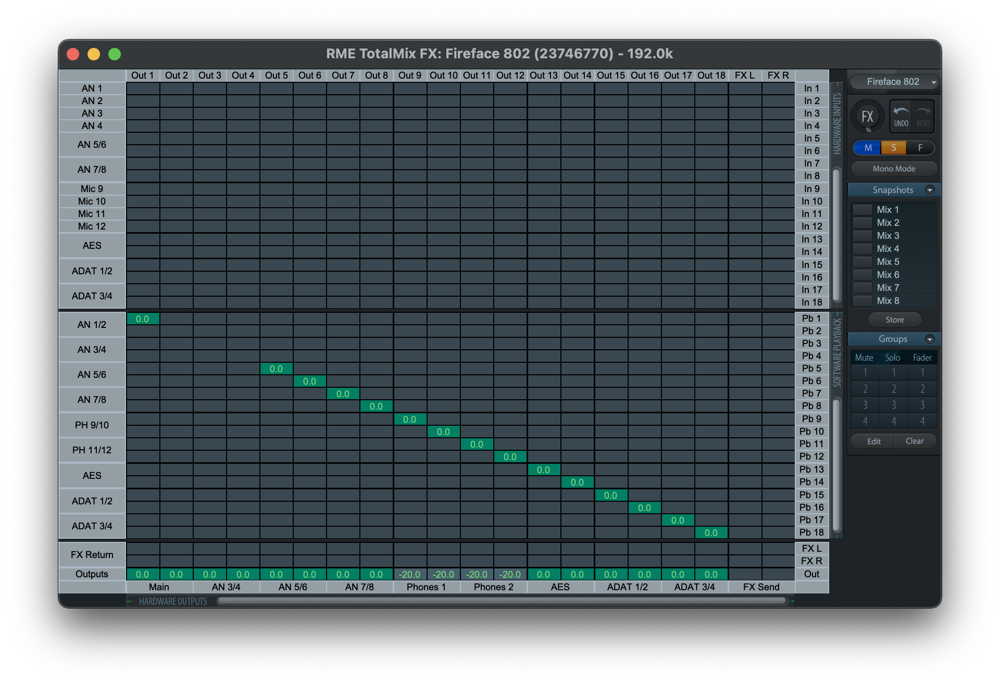

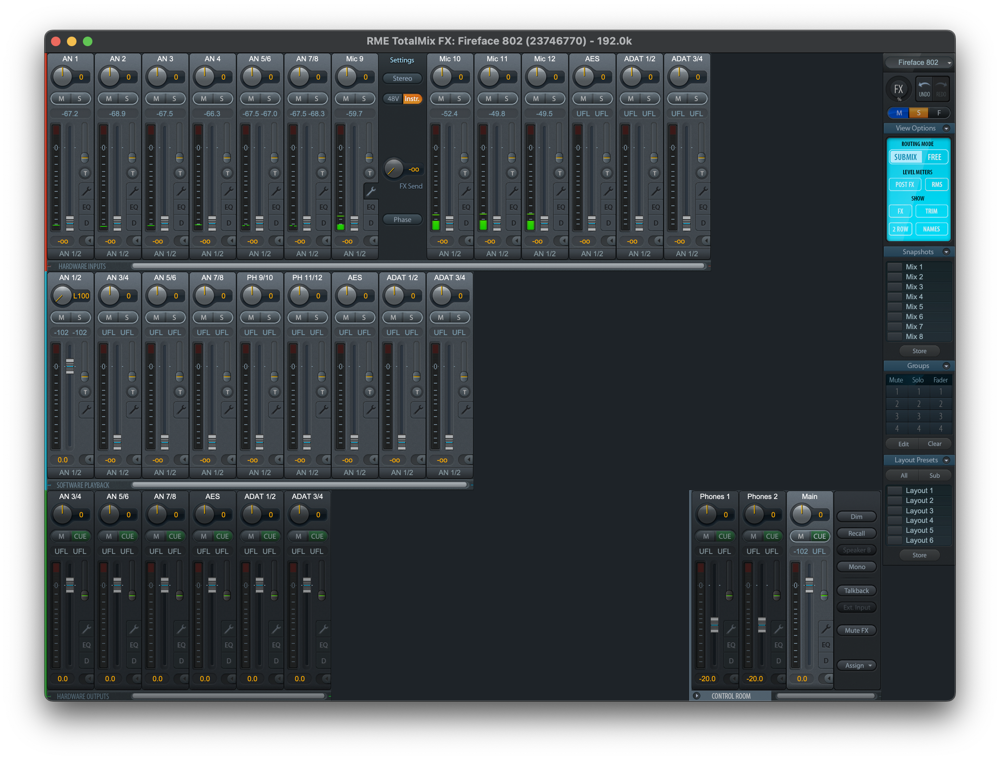

In [14]:
from IPython.display import Image
from IPython.display import display

display(
    Image(filename="./PXL_20250509_10061094.jpg", width=300),
    Image(filename="./PXL_20250509_10062195.jpg", width=300),
    Image(filename="./rme802_matrix.png", width=700),
    Image(filename="./rme802_mixer.png", width=700)
)

# Output signal
Out signal used during the recordings: 1-40Khz 5ms sweep.

/Users/alberto/anaconda3/envs/Tesipython/lib/python3.12/site-packages/matplotlib/axes/_axes.py:7947: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


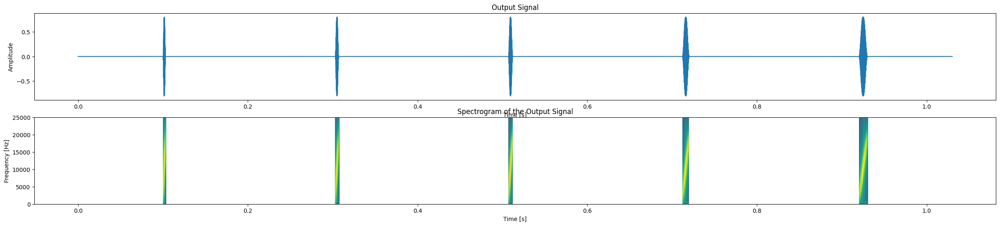

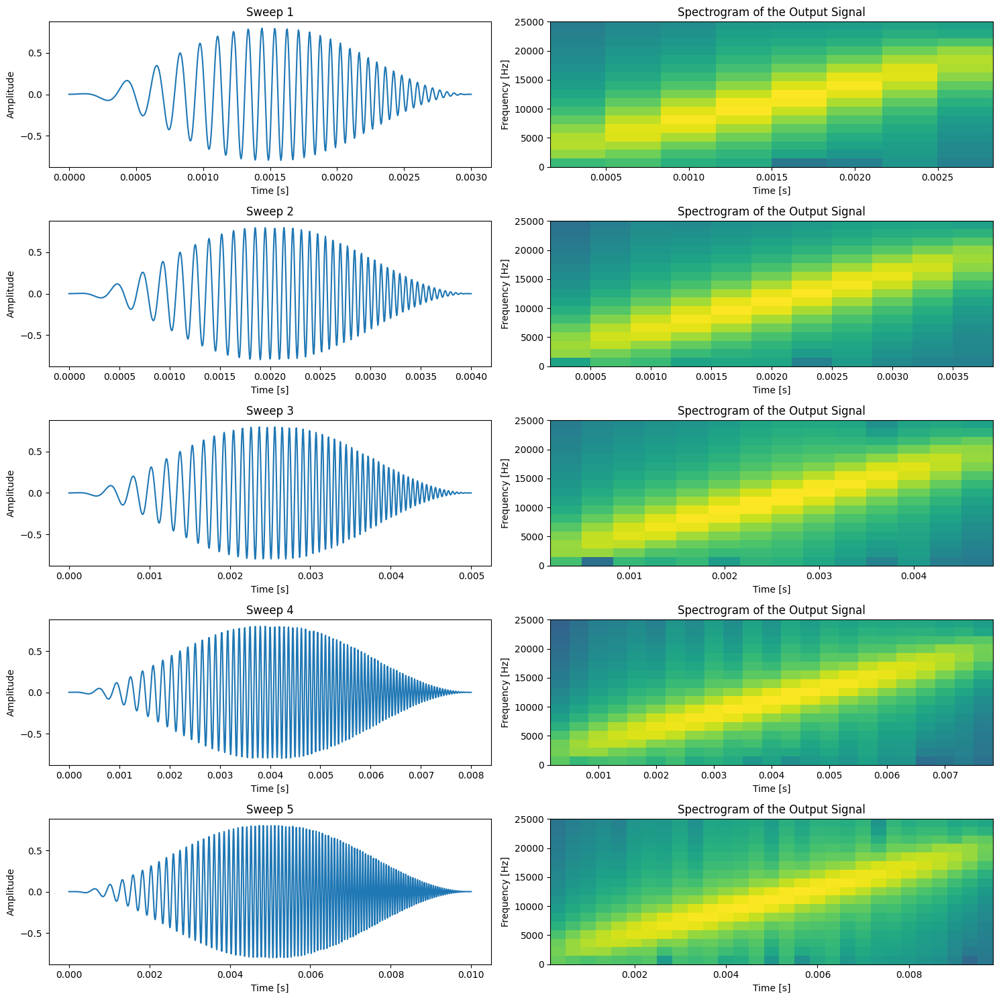

In [95]:
import scipy.signal as signal 
import numpy as np 
import matplotlib.pyplot as plt 
import sounddevice as sd
import soundfile as sf

#%%
# make a sweep
durns = np.array([3, 4, 5, 8, 10] )*1e-3
fs = 192000 # Hz

chirp = []
all_sweeps = []
for durn in durns:
    t = np.linspace(0, durn, int(fs*durn))
    start_f, end_f = 1e3, 20e3
    sweep = signal.chirp(t, start_f, t[-1], end_f)
    sweep *= signal.windows.tukey(sweep.size, 0.95)
    sweep *= 0.8
    sweep_padded = np.pad(sweep, pad_width=[int(fs*0.1)]*2, constant_values=[0,0])
    all_sweeps.append(sweep_padded)
    chirp.append(sweep)
    
sweeps_combined = np.concatenate(all_sweeps)
sf.write('1_20k_5sweeps.wav', sweeps_combined, samplerate=fs)

sweeps_combined = np.concatenate(all_sweeps)

# Read the saved WAV file
out_signal, _ = sf.read('1_20k_5sweeps.wav')

# Plot the time-domain signal and spectrogram
plt.figure(figsize=(30, 6))

# Time-domain plot
plt.subplot(2, 1, 1)
plt.plot(np.linspace(0, len(out_signal) / fs, len(out_signal)), out_signal)
plt.title('Output Signal')
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')

# Spectrogram plot
plt.subplot(2, 1, 2, sharex=plt.gca())
plt.specgram(out_signal, Fs=fs, NFFT=512, noverlap=256, cmap='viridis')
plt.title('Spectrogram of the Output Signal')
plt.xlabel('Time [s]')
plt.ylabel('Frequency [Hz]')
plt.ylim(0, 25e3)

# plot the chirp
plt.figure(figsize=(15, 15))
for i, sweep in enumerate(chirp):
    plt.subplot(len(chirp), 2, 2 * i + 1)
    plt.plot(np.linspace(0, len(sweep) / fs, len(sweep)), sweep)
    plt.title(f'Sweep {i+1}')
    plt.xlabel('Time [s]')
    plt.ylabel('Amplitude')
    # Spectrogram plot

    plt.subplot(len(chirp), 2, 2 * i + 2)
    plt.specgram(sweep, Fs=fs, NFFT=128, noverlap=64, cmap='viridis')
    plt.title('Spectrogram of the Output Signal')
    plt.xlabel('Time [s]')
    plt.ylabel('Frequency [Hz]')
    plt.ylim(0, 25e3)

plt.tight_layout()
plt.show()


# Analysis

1. Angular audiofile import and extraction from multiwav to single channel recordings


In [96]:
# %% Libraries and files
import os
import soundfile as sf

# Load audio files, then plot a 6x6 grid
DIR = "./2025-05-09/original/"  # Directory containing the audio files
audio_files = os.listdir(DIR)  # List all files in the sweeps directory
audio_files.sort()  # Sort the files in ascending order

# Directory to save the extracted channels
output_dir = "./2025-05-09/extracted_channels/"
os.makedirs(output_dir, exist_ok=True)  # Create the directory if it doesn't exist

# Path to the multi-channel WAV file
for file in audio_files:
    file_path = os.path.join(DIR, file)

    angle_name = file.split('.')[0]
    print(f"Processing file: {angle_name}")

    # Read the multi-channel WAV file
    audio_data, sample_rate = sf.read(DIR + file)

    # Check the shape of the audio data
    print(f"Audio data shape: {audio_data.shape}")  # (samples, channels)

    # Extract individual channels
    num_channels = audio_data.shape[1]  # Number of channels
    channels = [audio_data[:, i] for i in range(num_channels)]

    # Save each channel as a separate WAV file
    for i, channel_data in enumerate(channels):
        output_file = os.path.join(output_dir, angle_name+f"_{i + 1}.wav")  # Path to the output file
        sf.write(output_file, channel_data, sample_rate)
        print(f"Saved channel {i + 1} to {output_file}")


Processing file: 000
Audio data shape: (454134, 5)
Saved channel 1 to ./2025-05-09/extracted_channels/000_1.wav
Saved channel 2 to ./2025-05-09/extracted_channels/000_2.wav
Saved channel 3 to ./2025-05-09/extracted_channels/000_3.wav
Saved channel 4 to ./2025-05-09/extracted_channels/000_4.wav
Saved channel 5 to ./2025-05-09/extracted_channels/000_5.wav
Processing file: 010
Audio data shape: (380350, 5)
Saved channel 1 to ./2025-05-09/extracted_channels/010_1.wav
Saved channel 2 to ./2025-05-09/extracted_channels/010_2.wav
Saved channel 3 to ./2025-05-09/extracted_channels/010_3.wav
Saved channel 4 to ./2025-05-09/extracted_channels/010_4.wav
Saved channel 5 to ./2025-05-09/extracted_channels/010_5.wav
Processing file: 020
Audio data shape: (419955, 5)
Saved channel 1 to ./2025-05-09/extracted_channels/020_1.wav
Saved channel 2 to ./2025-05-09/extracted_channels/020_2.wav
Saved channel 3 to ./2025-05-09/extracted_channels/020_3.wav
Saved channel 4 to ./2025-05-09/extracted_channels/020

2. Sorting of the angular extracted files into the separate channels

In [97]:
# List all extracted channel files separated by channel number
from natsort import natsorted

# Directory containing the extracted channels
extracted_channels_dir = output_dir

# List all extracted channel files
channel_files = os.listdir(extracted_channels_dir)

# Filter out directories, keep only files
channel_files = [f for f in channel_files if os.path.isfile(os.path.join(extracted_channels_dir, f))]

# Sort the files naturally by the last part of their names (e.g., channel number)
sorted_channel_files = natsorted(channel_files, key=lambda x: int(x.split('_')[-1].split('.')[0]))

# Group files by the last part of their name (channel number)
grouped_files = {}

for file in sorted_channel_files:
    # Extract the channel number from the file name (e.g., "350_1.wav" -> "1")
    channel_number = int(file.split('_')[-1].split('.')[0])

    # Group files by channel number
    if channel_number not in grouped_files:
        grouped_files[channel_number] = []
    grouped_files[channel_number].append(file)

for i in range(len(grouped_files)):
    grouped_files[i+1].sort()

# Print grouped files
for channel_number, files in grouped_files.items():
    print(f"Channel {channel_number}:")
    for f in files:
        print(f"  {f}")


Channel 1:
  000_1.wav
  010_1.wav
  020_1.wav
  030_1.wav
  040_1.wav
  050_1.wav
  060_1.wav
  070_1.wav
  080_1.wav
  090_1.wav
  100_1.wav
  110_1.wav
  120_1.wav
  130_1.wav
  140_1.wav
  150_1.wav
  160_1.wav
  170_1.wav
  180_1.wav
  190_1.wav
  200_1.wav
  210_1.wav
  220_1.wav
  230_1.wav
  240_1.wav
  250_1.wav
  260_1.wav
  270_1.wav
  280_1.wav
  290_1.wav
  300_1.wav
  310_1.wav
  320_1.wav
  330_1.wav
  340_1.wav
  350_1.wav
  360_1.wav
Channel 2:
  000_2.wav
  010_2.wav
  020_2.wav
  030_2.wav
  040_2.wav
  050_2.wav
  060_2.wav
  070_2.wav
  080_2.wav
  090_2.wav
  100_2.wav
  110_2.wav
  120_2.wav
  130_2.wav
  140_2.wav
  150_2.wav
  160_2.wav
  170_2.wav
  180_2.wav
  190_2.wav
  200_2.wav
  210_2.wav
  220_2.wav
  230_2.wav
  240_2.wav
  250_2.wav
  260_2.wav
  270_2.wav
  280_2.wav
  290_2.wav
  300_2.wav
  310_2.wav
  320_2.wav
  330_2.wav
  340_2.wav
  350_2.wav
  360_2.wav
Channel 3:
  000_3.wav
  010_3.wav
  020_3.wav
  030_3.wav
  040_3.wav
  050_3.wav
  060_3

3. Matched filtering:
 - Every file is matched with the output
 - First sweep is extracted and displayed
 - Detected sweeps over a threshold value set in the peakfinding to avoid misvalues
 - First sweep is saved to a new directory to be analyzed 
 - avarage RMS of all the sweep in every recording is saved

Processing Channel 1:
Peaks detected in 000_1.wav: 8
RMS value of the first sweep in 000_1.wav: 0.12147
RMS value of sweep at peak 237034 in 000_1.wav: 0.12147
RMS value of sweep at peak 237046 in 000_1.wav: 0.12464
RMS value of sweep at peak 237059 in 000_1.wav: 0.12672
RMS value of sweep at peak 247012 in 000_1.wav: 0.09230
RMS value of sweep at peak 247024 in 000_1.wav: 0.10154
RMS value of sweep at peak 247036 in 000_1.wav: 0.11364
RMS value of sweep at peak 247048 in 000_1.wav: 0.12396
RMS value of sweep at peak 247061 in 000_1.wav: 0.13118
Average RMS value of all sweeps in 000_1.wav: 0.11693
Peaks detected in 010_1.wav: 9
RMS value of the first sweep in 010_1.wav: 0.11722
RMS value of sweep at peak 153690 in 010_1.wav: 0.11722
RMS value of sweep at peak 153702 in 010_1.wav: 0.12425
RMS value of sweep at peak 153714 in 010_1.wav: 0.12970
RMS value of sweep at peak 153727 in 010_1.wav: 0.13105
RMS value of sweep at peak 163680 in 010_1.wav: 0.09975
RMS value of sweep at peak 16369

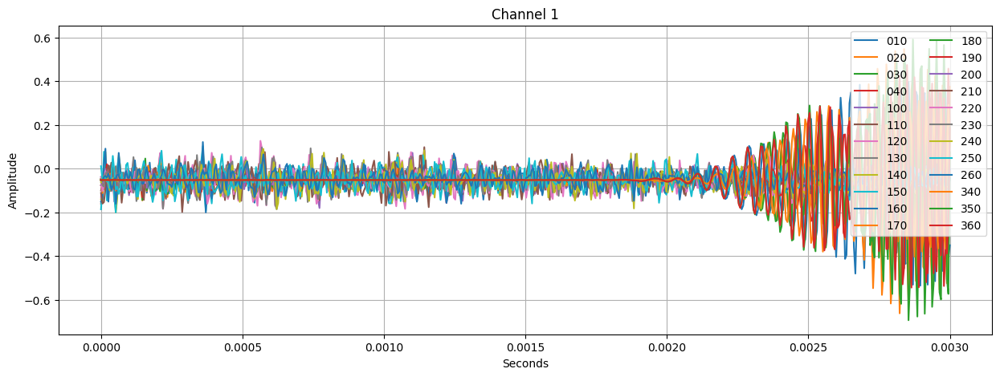

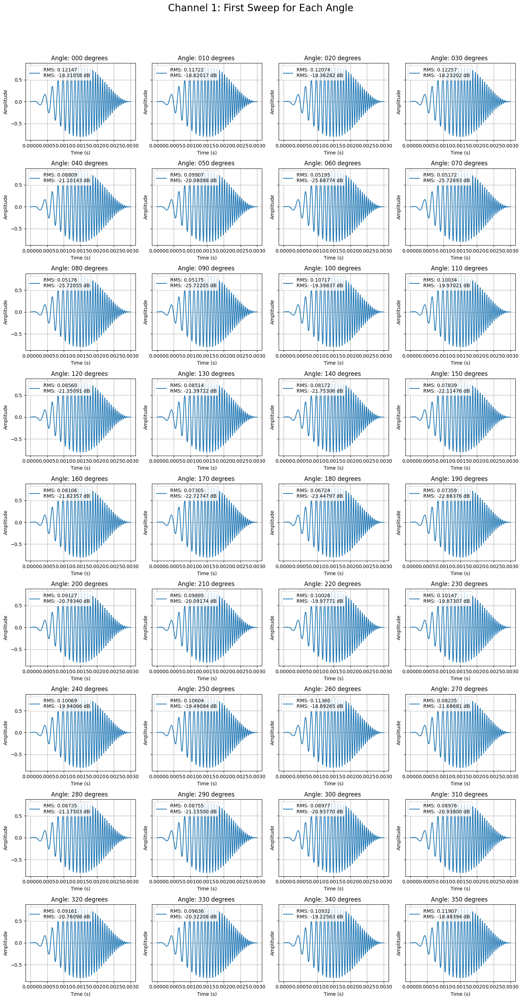

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Processing Channel 2:
Peaks detected in 000_2.wav: 10
RMS value of the first sweep in 000_2.wav: 0.13608
RMS value of sweep at peak 227186 in 000_2.wav: 0.13608
RMS value of sweep at peak 237022 in 000_2.wav: 0.15234
RMS value of sweep at peak 237034 in 000_2.wav: 0.15724
RMS value of sweep at peak 237046 in 000_2.wav: 0.16137
RMS value of sweep at peak 237059 in 000_2.wav: 0.16218
RMS value of sweep at peak 247012 in 000_2.wav: 0.13013
RMS value of sweep at peak 247024 in 000_2.wav: 0.14483
RMS value of sweep at peak 247036 in 000_2.wav: 0.15718
RMS value of sweep at peak 247048 in 000_2.wav: 0.16531
RMS value of sweep at peak 247060 in 000_2.wav: 0.17131
Average RMS value of all sweeps in 000_2.wav: 0.15380
Peaks detected in 010_2.wav: 13
RMS value of the first sweep in 010_2.wav: 0.14423
RMS value of sweep at peak 143841 in 010_2.wav: 0.14423
RMS value of sweep at peak 143853 in 010_2.wav: 0.14483
RMS value of sweep at peak 153678 in 010_2.wav: 0.15835
RMS value of sweep at peak 153

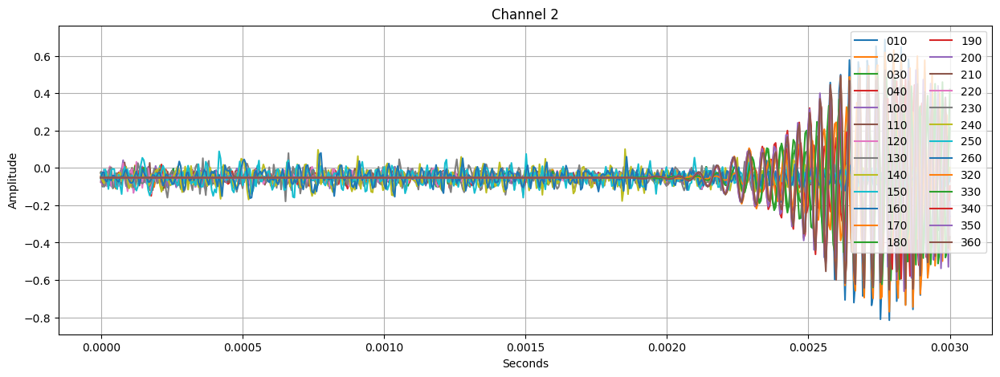

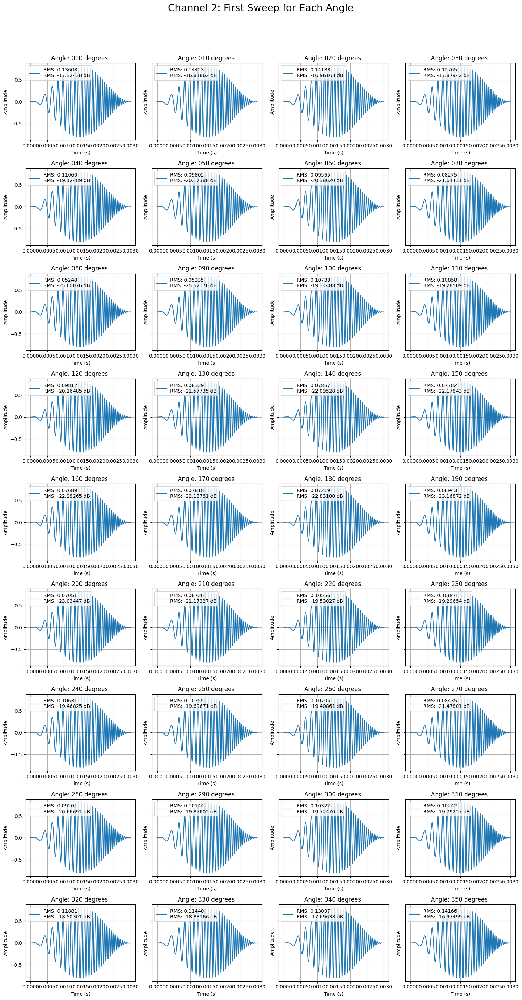

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Processing Channel 3:
Peaks detected in 000_3.wav: 9
RMS value of the first sweep in 000_3.wav: 0.15405
RMS value of sweep at peak 237022 in 000_3.wav: 0.15405
RMS value of sweep at peak 237034 in 000_3.wav: 0.15604
RMS value of sweep at peak 237046 in 000_3.wav: 0.15743
RMS value of sweep at peak 237059 in 000_3.wav: 0.15790
RMS value of sweep at peak 247012 in 000_3.wav: 0.13445
RMS value of sweep at peak 247024 in 000_3.wav: 0.14941
RMS value of sweep at peak 247036 in 000_3.wav: 0.16196
RMS value of sweep at peak 247048 in 000_3.wav: 0.16875
RMS value of sweep at peak 247060 in 000_3.wav: 0.17151
Average RMS value of all sweeps in 000_3.wav: 0.15683
Peaks detected in 010_3.wav: 10
RMS value of the first sweep in 010_3.wav: 0.12740
RMS value of sweep at peak 143853 in 010_3.wav: 0.12740
RMS value of sweep at peak 153690 in 010_3.wav: 0.14378
RMS value of sweep at peak 153701 in 010_3.wav: 0.14802
RMS value of sweep at peak 153714 in 010_3.wav: 0.15088
RMS value of sweep at peak 1537

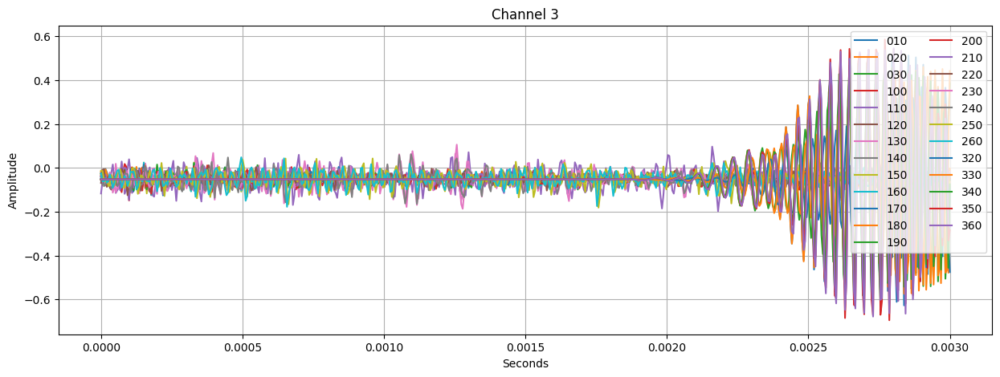

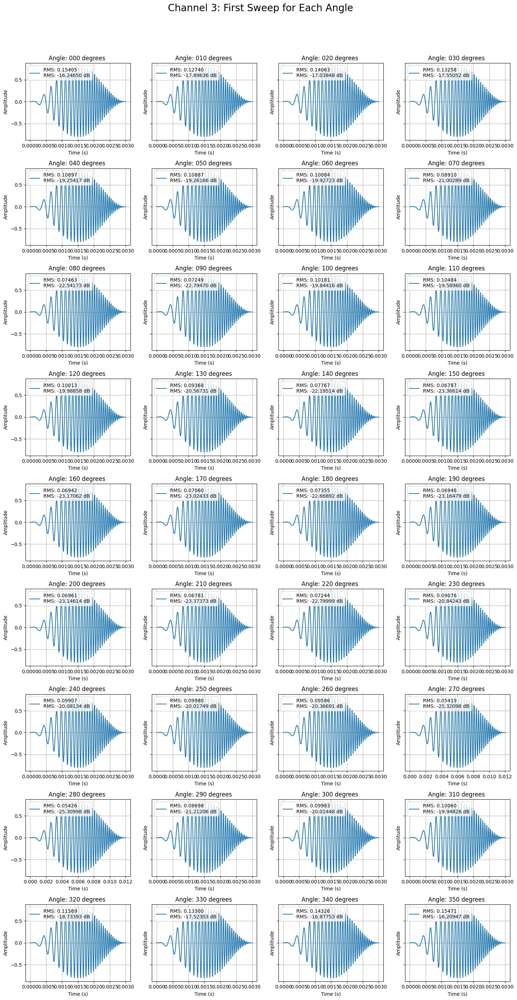

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Processing Channel 4:
Peaks detected in 000_4.wav: 8
RMS value of the first sweep in 000_4.wav: 0.14750
RMS value of sweep at peak 237034 in 000_4.wav: 0.14750
RMS value of sweep at peak 237046 in 000_4.wav: 0.15202
RMS value of sweep at peak 237059 in 000_4.wav: 0.15282
RMS value of sweep at peak 247012 in 000_4.wav: 0.11640
RMS value of sweep at peak 247024 in 000_4.wav: 0.12600
RMS value of sweep at peak 247036 in 000_4.wav: 0.13961
RMS value of sweep at peak 247048 in 000_4.wav: 0.15089
RMS value of sweep at peak 247060 in 000_4.wav: 0.15936
Average RMS value of all sweeps in 000_4.wav: 0.14307
Peaks detected in 010_4.wav: 7
RMS value of the first sweep in 010_4.wav: 0.13874
RMS value of sweep at peak 153701 in 010_4.wav: 0.13874
RMS value of sweep at peak 153713 in 010_4.wav: 0.14100
RMS value of sweep at peak 153726 in 010_4.wav: 0.14266
RMS value of sweep at peak 163691 in 010_4.wav: 0.12546
RMS value of sweep at peak 163703 in 010_4.wav: 0.13600
RMS value of sweep at peak 16371

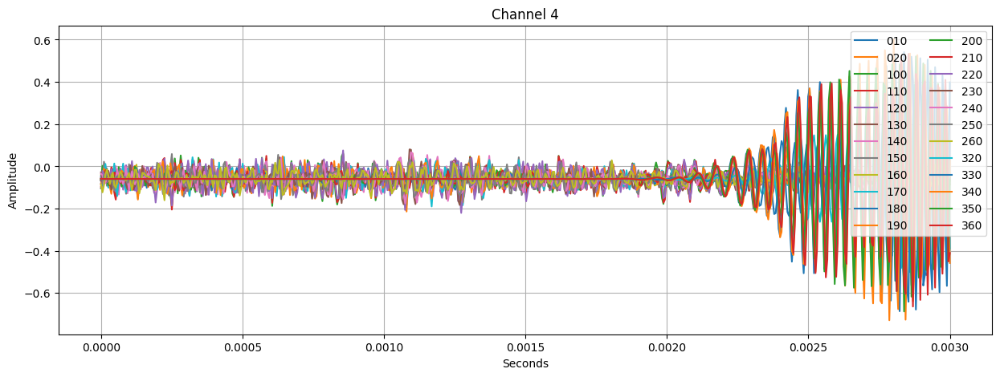

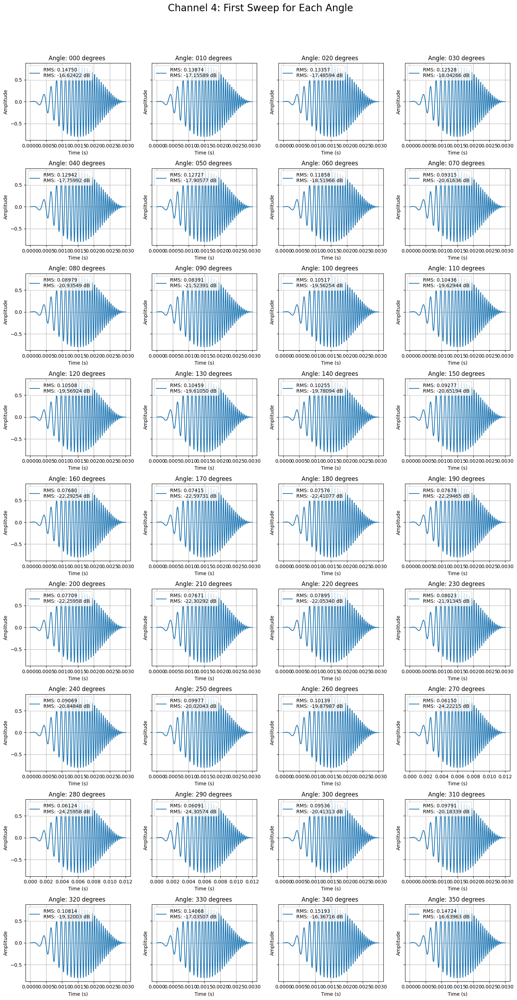

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Processing Channel 5:
Peaks detected in 000_5.wav: 5
RMS value of the first sweep in 000_5.wav: 0.12690
RMS value of sweep at peak 237046 in 000_5.wav: 0.12690
RMS value of sweep at peak 237059 in 000_5.wav: 0.12874
RMS value of sweep at peak 247036 in 000_5.wav: 0.12292
RMS value of sweep at peak 247048 in 000_5.wav: 0.12856
RMS value of sweep at peak 247061 in 000_5.wav: 0.13285
Average RMS value of all sweeps in 000_5.wav: 0.12800
Peaks detected in 010_5.wav: 0
No sweeps detected in 010_5.wav - Channel 5
Peaks detected in 020_5.wav: 0
No sweeps detected in 020_5.wav - Channel 5
Peaks detected in 030_5.wav: 0
No sweeps detected in 030_5.wav - Channel 5
Peaks detected in 040_5.wav: 0
No sweeps detected in 040_5.wav - Channel 5
Peaks detected in 050_5.wav: 0
No sweeps detected in 050_5.wav - Channel 5
Peaks detected in 060_5.wav: 0
No sweeps detected in 060_5.wav - Channel 5
Peaks detected in 070_5.wav: 0
No sweeps detected in 070_5.wav - Channel 5
Peaks detected in 080_5.wav: 0
No swe

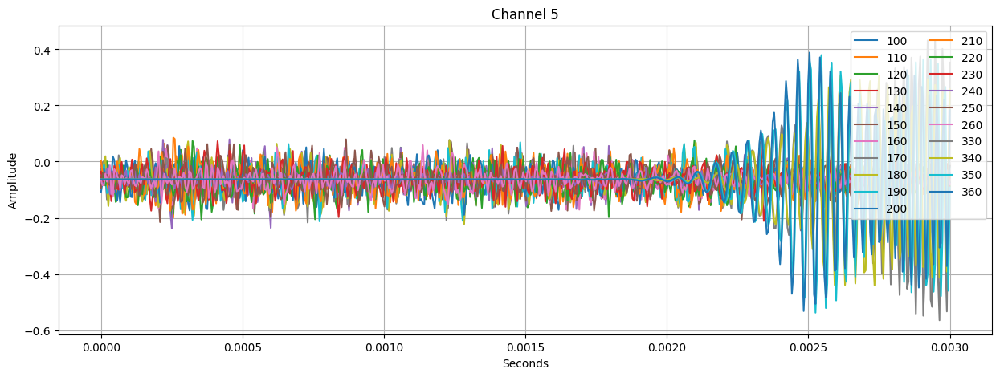

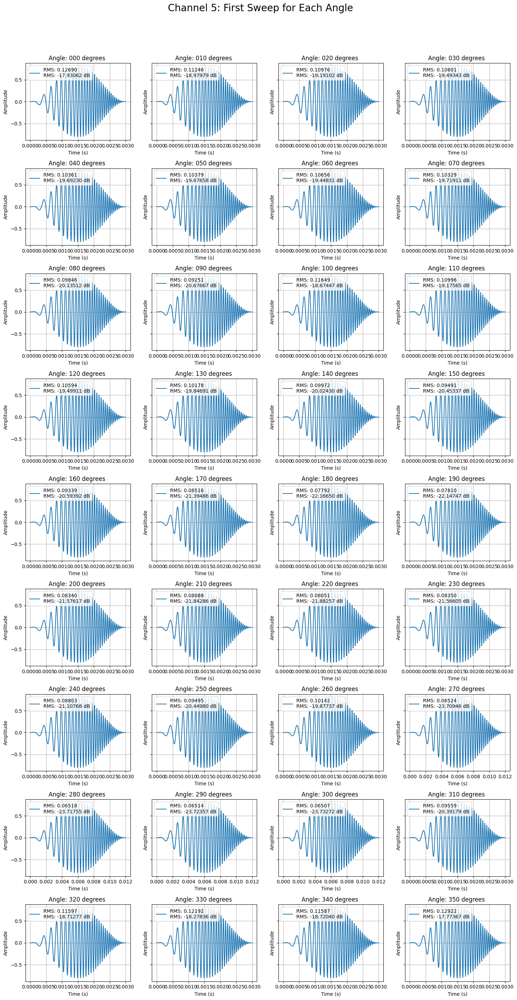

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.



RMS Values for All Files:
000_1.wav: 0.12147
010_1.wav: 0.11722
020_1.wav: 0.12074
030_1.wav: 0.12257
040_1.wav: 0.08809
100_1.wav: 0.10717
110_1.wav: 0.10034
120_1.wav: 0.08560
130_1.wav: 0.08514
140_1.wav: 0.08172
150_1.wav: 0.07839
160_1.wav: 0.08106
170_1.wav: 0.07305
180_1.wav: 0.06724
190_1.wav: 0.07359
200_1.wav: 0.09127
210_1.wav: 0.09895
220_1.wav: 0.10026
230_1.wav: 0.10147
240_1.wav: 0.10069
250_1.wav: 0.10604
260_1.wav: 0.11360
340_1.wav: 0.10932
350_1.wav: 0.11907
360_1.wav: 0.12147
000_2.wav: 0.13608
010_2.wav: 0.14423
020_2.wav: 0.14188
030_2.wav: 0.12765
040_2.wav: 0.11060
100_2.wav: 0.10783
110_2.wav: 0.10858
120_2.wav: 0.09812
130_2.wav: 0.08339
140_2.wav: 0.07857
150_2.wav: 0.07782
160_2.wav: 0.07689
170_2.wav: 0.07818
180_2.wav: 0.07219
190_2.wav: 0.06943
200_2.wav: 0.07051
210_2.wav: 0.08736
220_2.wav: 0.10556
230_2.wav: 0.10844
240_2.wav: 0.10631
250_2.wav: 0.10355
260_2.wav: 0.10705
320_2.wav: 0.11881
330_2.wav: 0.11440
340_2.wav: 0.13037
350_2.wav: 0.14166
360_

In [ ]:
# Define the matched filter function
def matched_filter(recording, chirp_template):
    chirp_template = chirp_template[::-1]  # Time-reversed chirp
    filtered_output = signal.fftconvolve(recording, chirp_template, mode='valid')
    return filtered_output

# Detect peaks in the matched filter output
def detect_peaks(filtered_output, threshold=0.8):
    peaks, _ = signal.find_peaks(filtered_output, prominence=threshold)
    return peaks

# Process each channel
DIR_first_sweep = extracted_channels_dir + "first_sweep/"  # Directory to save the first sweeps
os.makedirs(DIR_first_sweep, exist_ok=True)  # Create the directory if it doesn't exist

# Dictionary to store RMS values for all files
rms_values_dict = {}

channel_number = 1
for i in range(len(grouped_files)):
    files = grouped_files[i+1]
    print(f"Processing Channel {channel_number}:")
    
    # Create a new figure for each channel
    fig, ax = plt.subplots(figsize=(15, 5))
    ax.set_title(f"Channel {channel_number}")
    ax.set_xlabel("Seconds")
    ax.set_ylabel("Amplitude")
    ax.grid(True)

    for file in files[0:(len(files))]:
        file_path = os.path.join(extracted_channels_dir, file)
        recording, sample_rate = sf.read(file_path)

        # Apply matched filtering
        filtered_output = matched_filter(recording, chirp[0])

        # Detect peaks
        peaks = detect_peaks(filtered_output)
        print(f"Peaks detected in {file}: {len(peaks)}")
        
        if len(peaks) > 0:
            # Extract the first sweep
            first_sweep_start = peaks[0] 
            first_sweep_end = first_sweep_start + len(chirp[0])
            first_sweep = recording[first_sweep_start:first_sweep_end]

            # Calculate RMS value of the first sweep
            rms_first_sweep = np.sqrt(np.mean(first_sweep**2))
            print(f"RMS value of the first sweep in {file}: {rms_first_sweep:.5f}")

            # Store RMS value in the dictionary
            rms_values_dict[file] = rms_first_sweep

            # Calculate RMS values for all detected peaks
            rms_values = []
            for peak in peaks:
                sweep_start = peak
                sweep_end = sweep_start + len(chirp[0])
                sweep = recording[sweep_start:sweep_end]
                rms = np.sqrt(np.mean(sweep**2))
                rms_values.append(rms)
                print(f"RMS value of sweep at peak {peak} in {file}: {rms:.5f}")
            
            # Calculate the average RMS value of all peaks
            average_rms = np.mean(rms_values)

            print(f"Average RMS value of all sweeps in {file}: {average_rms:.5f}")

            sf.write(DIR_first_sweep + file, first_sweep, int(fs))
            # Plot the first sweep
            angle_name = file.split('_')[0]
            if int(angle_name):
                ax.plot(np.linspace(0,len(first_sweep),len(first_sweep))/fs, sweep, label=f"{angle_name}")
                ax.legend(loc = 'upper right', ncol = 2)

        else:
            print(f"No sweeps detected in {file} - Channel {channel_number}")
        

    # Plot all angles, skipping '360'
    fig1, axs = plt.subplots(9, 4, figsize=(15, 30), sharey=True)
    angles = [file.split('_')[0] for file in files]  # Extract angle names from filenames

    idx_to_plot = 0
    for idx, file in enumerate(files):
        if angles[idx] == '360':
            continue  # Skip the 360 angle

        file_path = os.path.join(DIR_first_sweep, file)
        audio, fs = sf.read(file_path)

        rms = np.sqrt(np.mean(audio**2))
        rms_db = 20 * np.log10(rms)
        
        row = idx_to_plot // 4
        col = idx_to_plot % 4
        
        ax = axs[row, col]
        ax.plot(np.linspace(0, len(audio) / fs, len(audio)), audio)
        ax.set_title(f"Angle: {angles[idx]} degrees ")  # Use extracted angle name with units
        ax.set_xlabel("Time (s)")
        ax.set_ylabel("Amplitude")
        ax.grid(True)
        ax.legend([f'RMS: {rms:.5f}\nRMS: {rms_db:.5f} dB'], loc='upper left')

        idx_to_plot += 1

    plt.suptitle(f"Channel {channel_number}: First Sweep for Each Angle", fontsize=20)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust layout to make room for suptitle
    plt.show(block = False)

    ax.legend()
    channel_number += 1

plt.show(block = False)

# Print the dictionary of RMS values
print("\nRMS Values for All Files:")
for file, rms_value in rms_values_dict.items():
    print(f"{file}: {rms_value:.5f}")

4. RMS values of the *whole file* is calculated and displayed in a polar plot

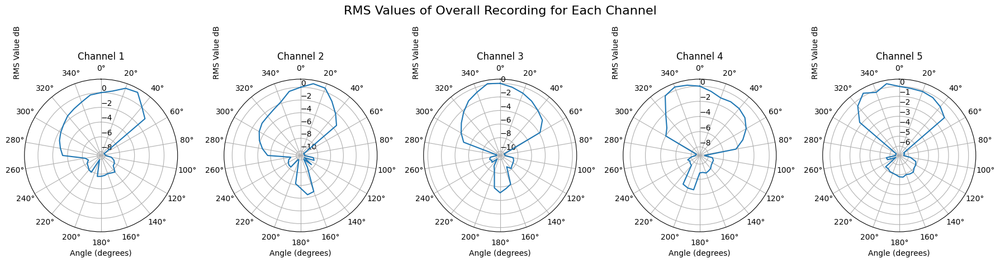

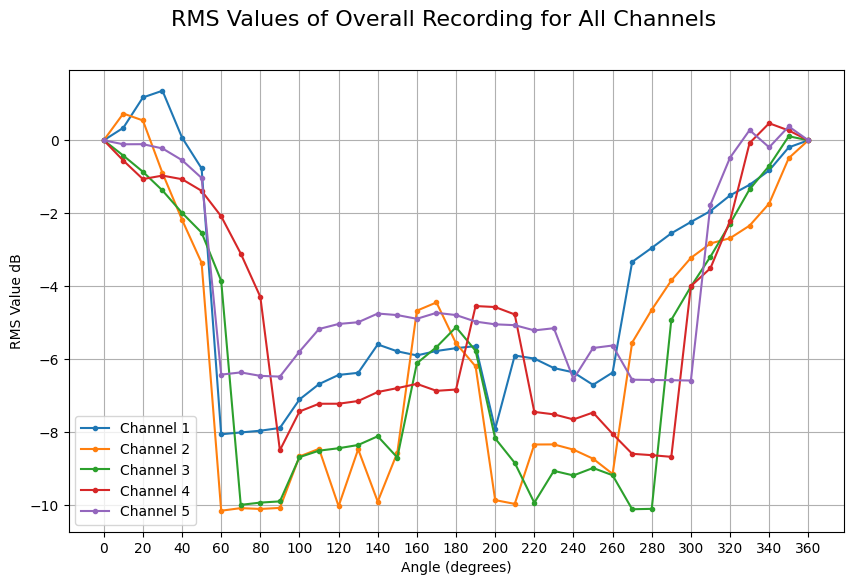

In [94]:
# RMS values of the overall recording for each channel and each angle

num_channels = len(grouped_files)
fig_polar, axs_polar = plt.subplots(1, num_channels, figsize=(18, 5), subplot_kw={'projection': 'polar'})
fig_polar.suptitle("RMS Values of Overall Recording for Each Channel", fontsize=16)

for i in range(num_channels):
    channel_number = i + 1
    files = grouped_files[channel_number]
    
    rms_values = []
    rms_values_norm_db = []
    angles = []
    
    for file in files:
        file_path = os.path.join(extracted_channels_dir, file)
        rms = rms_values_dict[file]
        rms_values.append(rms)

        rms_values_norm = rms_values / rms_values[0]
        rms_values_norm_db = 20 * np.log10(rms_values_norm)

        angle_name = file.split('_')[0]
        angles.append(int(angle_name))
    
    # Convert angles to radians
    angles_rad = np.radians(angles)
    
    # Plot RMS values in polar plot
    ax_polar = axs_polar[i] if num_channels > 1 else axs_polar
    ax_polar.plot(angles_rad, rms_values_norm_db, linestyle='-', label=f"Channel {channel_number}")
    ax_polar.set_title(f"Channel {channel_number}")
    ax_polar.set_theta_zero_location("N")  # Set 0 degrees to North
    ax_polar.set_theta_direction(-1)  # Set clockwise direction
    ax_polar.set_xticks(np.linspace(0, 2 * np.pi, 18, endpoint=False))  # Set angle ticks
    ax_polar.set_xlabel("Angle (degrees)")
    ax_polar.set_ylabel("RMS Value dB", position=(0, 1), ha='left')
    ax_polar.set_rlabel_position(0)

# Linear plot of all channels
fig_linear, ax_linear = plt.subplots(figsize=(10, 6))
fig_linear.suptitle("RMS Values of Overall Recording for All Channels", fontsize=16)

for i in range(num_channels):
    channel_number = i + 1
    files = grouped_files[channel_number]
    
    rms_values = []
    angles = []
    
    for file in files:
        file_path = os.path.join(extracted_channels_dir, file)
        rms = rms_values_dict[file]
        rms_values.append(rms)

        rms_values_norm = rms_values / rms_values[0]
        rms_values_norm_db = 20 * np.log10(rms_values_norm)
        
        angle_name = file.split('_')[0]
        angles.append(int(angle_name))
    
    # Plot RMS values in linear plot
    ax_linear.plot(angles, rms_values_norm_db, marker='.', linestyle='-', label=f"Channel {channel_number}")

ax_linear.set_xlabel("Angle (degrees)")
ax_linear.set_xticks(np.linspace(0, 380, 19, endpoint=False))  # Set angle ticks
ax_linear.set_ylabel("RMS Value dB")
ax_linear.legend()
ax_linear.grid(True)

fig_polar.tight_layout()
plt.show(block = False)


5. Frequncy analysis of every channel up to 40 KHz

In [82]:
# import soundfile as sf
# from scipy import fft

# # Central frequencies of the bands
# central_freq = np.array([4e3, 6e3, 8e3, 10e3, 12e3, 14e3, 16e3, 18e3, 20e3, 22e3, 24e3, 26e3, 28e3, 30e3, 32e3, 34e3, 36e3, 38e3])
# BW = 1e3  # Bandwidth of the bands
# linestyles = ["-", "--", "-.", ":", "-", "--"]  # Line styles for the plot

# # Group central frequencies into 3 sets of 6 bands each
# num_bands_per_plot = 6
# central_freq_sets = [central_freq[i * num_bands_per_plot:(i + 1) * num_bands_per_plot] for i in range(3)]

# # Number of microphones
# num_mics = num_channels

# # Plot for each microphone
# for mic in range(1, num_mics + 1):
#     files = grouped_files[mic]
#     angles = [int(file.split('_')[0]) for file in files]  # Extract angles from filenames

#     # Create a figure with 3 polar subplots
#     fig, axes = plt.subplots(1, 3, subplot_kw={"projection": "polar"}, figsize=(15, 5))
#     plt.suptitle(f"Polar Frequency Response - Microphone {mic}", fontsize=20)

#     for ax_idx, ax in enumerate(axes):
#         ii = 0
#         for fc in central_freq_sets[ax_idx]:
            
#             audio_patt = []

#             for file in files:
#                 file_path = os.path.join(DIR_first_sweep, file)
#                 audio, fs = sf.read(file_path)

#                 # Compute FFT
#                 audio_freq = fft.fft(audio, n=2048)
#                 audio_freq = audio_freq[:1024]
#                 freqs = fft.fftfreq(2048, 1 / fs)[:1024]

#                 # Compute mean radiance in the band
#                 band_mean = np.mean(np.abs(audio_freq[(freqs > fc - BW) & (freqs < fc + BW)]))
#                 audio_patt.append(band_mean)

#             # Normalize and plot
#             audio_patt_norm = audio_patt / audio_patt[0] # Normalize the radiance
#             audio_patt_norm_dB = 20 * np.log10(audio_patt_norm) # Convert the radiance to dB
            
#             if fc >= 10e3:
#                 label = f"{fc / 1e3:.0f} kHz"
#             else:
#                 label = f"{fc / 1e3:.0f} kHz"
            
#             ax.plot(np.deg2rad(angles), audio_patt_norm_dB, label=label, linestyle=linestyles[ii])
#             ii +=1
#         # Configure polar plot
#         ax.legend(loc="upper right")
#         ax.set_theta_offset(np.pi / 2)
#         ax.set_theta_zero_location("N")  # Set 0 degrees to North
#         ax.set_theta_direction(-1)  # Set clockwise direction
#         ax.set_xticks(np.linspace(0, 2 * np.pi, 18, endpoint=False))  # Set angle ticks
#         ax.set_yticks(np.linspace(-35, 0, 6))
#         ax.set_xlabel("Angle (degrees)")
#         ax.set_ylabel("RMS Value dB", position=(0, 1), ha='left')
#         ax.set_rlabel_position(0)


#     plt.tight_layout()

#     plt.show()

# Final notes

- 3 mics have a negative bias around -0.053, mic 3 at -0.065 and mic 4 at -0.060. 
- There is a different zero bias across microphones, but the diffence is pretty low (approximately 10% of the first sweep amplitude)
- frequency analysis shows a clear pattern connected to the microphopne position along the array: mic1 (on the left of the robot) has a bias to pick up more on its left side across all frequncies.   Similarly for mic5 (last on the right) accordingly.
